In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE
from ydata_profiling import ProfileReport
from pandas.core.dtypes.common import is_numeric_dtype
from sklearn.preprocessing import LabelEncoder,MinMaxScaler
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import classification_report,accuracy_score, confusion_matrix
#model
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

In [2]:
url = 'https://raw.githubusercontent.com/rashakil-ds/Public-Datasets/refs/heads/main/Bank%20Data.csv'
df = pd.read_csv(url)

In [3]:
df.head(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,2022.0,Good,809.98,35.030402,22 Years and 9 Months,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.053114,22 Years and 10 Months,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.811894,NaN,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24_,821-00-0265,Scientist,19114.12,NaN,3,...,4.0,Good,809.98,32.430559,23 Years and 0 Months,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,_______,34847.84,3037.986667,2,...,5.0,Good,605.03,25.926822,27 Years and 3 Months,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


In [4]:
df.tail(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
49995,0x25fe5,CUS_0x8600,December,Sarah McBridec,4975,031-35-0942,Architect,20002.88,1929.906667,10,...,12.0,_,3571.7,34.780553,NaN,Yes,60.964772,146.48632477751087,Low_spent_Small_value_payments,275.53956951573343
49996,0x25fee,CUS_0x942c,September,Nicks,25,078-73-5990,Mechanic,39628.99,NaN,4,...,7.0,Good,502.38,27.758522,31 Years and 11 Months,NM,35.104023,181.44299902757518,Low_spent_Small_value_payments,409.39456169535066
49997,0x25fef,CUS_0x942c,October,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,7.0,Good,502.38,36.858542,32 Years and 0 Months,No,35.104023,__10000__,Low_spent_Large_value_payments,349.7263321025098
49998,0x25ff0,CUS_0x942c,November,Nicks,25,078-73-5990,Mechanic,39628.99,NaN,4,...,7.0,Good,502.38,39.139840,32 Years and 1 Months,No,35.104023,97.59857973344877,High_spent_Small_value_payments,463.23898098947717
49999,0x25ff1,CUS_0x942c,December,Nicks,25,078-73-5990,Mechanic,39628.99,3359.415833,4,...,7.0,_,502.38,34.108530,32 Years and 2 Months,No,35.104023,220.45787812168732,Low_spent_Medium_value_payments,360.37968260123847


In [6]:
df.to_csv('Cridet health.csv')

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ID                        50000 non-null  object 
 1   Customer_ID               50000 non-null  object 
 2   Month                     50000 non-null  object 
 3   Name                      44985 non-null  object 
 4   Age                       50000 non-null  object 
 5   SSN                       50000 non-null  object 
 6   Occupation                50000 non-null  object 
 7   Annual_Income             50000 non-null  object 
 8   Monthly_Inhand_Salary     42502 non-null  float64
 9   Num_Bank_Accounts         50000 non-null  int64  
 10  Num_Credit_Card           50000 non-null  int64  
 11  Interest_Rate             50000 non-null  int64  
 12  Num_of_Loan               50000 non-null  object 
 13  Type_of_Loan              44296 non-null  object 
 14  Delay_

In [8]:
df.isnull().any()

ID                          False
Customer_ID                 False
Month                       False
Name                         True
Age                         False
SSN                         False
Occupation                  False
Annual_Income               False
Monthly_Inhand_Salary        True
Num_Bank_Accounts           False
Num_Credit_Card             False
Interest_Rate               False
Num_of_Loan                 False
Type_of_Loan                 True
Delay_from_due_date         False
Num_of_Delayed_Payment       True
Changed_Credit_Limit        False
Num_Credit_Inquiries         True
Credit_Mix                  False
Outstanding_Debt            False
Credit_Utilization_Ratio    False
Credit_History_Age           True
Payment_of_Min_Amount       False
Total_EMI_per_month         False
Amount_invested_monthly      True
Payment_Behaviour           False
Monthly_Balance              True
dtype: bool

In [9]:
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                        5015
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary       7498
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                5704
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit           0
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age          4470
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              562
dtype: int64

In [10]:
df.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance'],
      dtype='object')

In [11]:
df.drop(['ID','Month','Name', 'Age', 'SSN', 'Occupation','Num_Bank_Accounts','Type_of_Loan','Num_Credit_Inquiries','Payment_of_Min_Amount','Total_EMI_per_month','Changed_Credit_Limit','Monthly_Balance'],axis=1,inplace=True)

In [12]:
df.head(5)

,Customer_ID,Annual_Income,Monthly_Inhand_Salary,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Amount_invested_monthly,Payment_Behaviour
0,CUS_0xd40,19114.12,1824.843333,4,3,4,3,7,Good,809.98,35.030402,22 Years and 9 Months,236.64268203272135,Low_spent_Small_value_payments
1,CUS_0xd40,19114.12,1824.843333,4,3,4,3,9,Good,809.98,33.053114,22 Years and 10 Months,21.465380264657146,High_spent_Medium_value_payments
2,CUS_0xd40,19114.12,1824.843333,4,3,4,-1,4,Good,809.98,33.811894,NaN,148.23393788500925,Low_spent_Medium_value_payments
3,CUS_0xd40,19114.12,NaN,4,3,4,4,5,Good,809.98,32.430559,23 Years and 0 Months,39.08251089460281,High_spent_Medium_value_payments
4,CUS_0x21b1,34847.84,3037.986667,4,6,1,3,1,Good,605.03,25.926822,27 Years and 3 Months,39.684018417945296,High_spent_Large_value_payments


In [13]:
df.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
49995    False
49996    False
49997    False
49998    False
49999    False
Length: 50000, dtype: bool

In [14]:
df.dropna(inplace=True)

In [15]:
df.isnull().any()

Customer_ID                 False
Annual_Income               False
Monthly_Inhand_Salary       False
Num_Credit_Card             False
Interest_Rate               False
Num_of_Loan                 False
Delay_from_due_date         False
Num_of_Delayed_Payment      False
Credit_Mix                  False
Outstanding_Debt            False
Credit_Utilization_Ratio    False
Credit_History_Age          False
Amount_invested_monthly     False
Payment_Behaviour           False
dtype: bool

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 34358 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Customer_ID               34358 non-null  object 
 1   Annual_Income             34358 non-null  object 
 2   Monthly_Inhand_Salary     34358 non-null  float64
 3   Num_Credit_Card           34358 non-null  int64  
 4   Interest_Rate             34358 non-null  int64  
 5   Num_of_Loan               34358 non-null  object 
 6   Delay_from_due_date       34358 non-null  int64  
 7   Num_of_Delayed_Payment    34358 non-null  object 
 8   Credit_Mix                34358 non-null  object 
 9   Outstanding_Debt          34358 non-null  object 
 10  Credit_Utilization_Ratio  34358 non-null  float64
 11  Credit_History_Age        34358 non-null  object 
 12  Amount_invested_monthly   34358 non-null  object 
 13  Payment_Behaviour         34358 non-null  object 
dtypes: float64(

In [17]:
label = LabelEncoder()

In [18]:
for column in df.columns:
    if is_numeric_dtype(df[column]):
        continue
    else:
        df[column] = label.fit_transform(df[column])

In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 34358 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Customer_ID               34358 non-null  int64  
 1   Annual_Income             34358 non-null  int64  
 2   Monthly_Inhand_Salary     34358 non-null  float64
 3   Num_Credit_Card           34358 non-null  int64  
 4   Interest_Rate             34358 non-null  int64  
 5   Num_of_Loan               34358 non-null  int64  
 6   Delay_from_due_date       34358 non-null  int64  
 7   Num_of_Delayed_Payment    34358 non-null  int64  
 8   Credit_Mix                34358 non-null  int64  
 9   Outstanding_Debt          34358 non-null  int64  
 10  Credit_Utilization_Ratio  34358 non-null  float64
 11  Credit_History_Age        34358 non-null  int64  
 12  Amount_invested_monthly   34358 non-null  int64  
 13  Payment_Behaviour         34358 non-null  int64  
dtypes: float64(

In [20]:
df.describe()

,Customer_ID,Annual_Income,Monthly_Inhand_Salary,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Amount_invested_monthly,Payment_Behaviour
count,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000,34358.000000
mean,6180.998894,7418.689912,4177.226043,22.035043,70.072123,88.331859,21.095058,127.291926,1.568892,6205.796176,32.294293,189.800134,17073.083736,3.453199
std,3571.016373,4262.272589,3168.845513,125.654137,456.828901,57.777973,14.818206,108.849053,1.010329,3592.750274,5.107961,109.704811,9861.924021,2.033256
min,0.000000,0.000000,303.645417,0.000000,1.000000,0.000000,-5.000000,0.000000,0.000000,0.000000,20.509652,0.000000,0.000000,0.000000
25%,3086.250000,3723.000000,1623.664167,4.000000,8.000000,3.000000,10.000000,56.000000,1.000000,3076.000000,28.091908,99.000000,8518.250000,2.000000
50%,6184.000000,7459.000000,3086.756667,5.000000,13.000000,93.000000,18.000000,91.000000,2.000000,6203.000000,32.286465,176.000000,17107.500000,3.000000
75%,9265.000000,11095.750000,5934.251014,7.000000,20.000000,124.000000,28.000000,157.000000,2.000000,9333.000000,36.474415,284.000000,25696.750000,6.000000
max,12363.000000,14780.000000,15204.633333,1499.000000,5799.000000,200.000000,67.000000,354.000000,3.000000,12394.000000,48.540663,398.000000,32747.000000,6.000000


array([[<Axes: title={'center': 'Customer_ID'}>,
        <Axes: title={'center': 'Annual_Income'}>,
        <Axes: title={'center': 'Monthly_Inhand_Salary'}>,
        <Axes: title={'center': 'Num_Credit_Card'}>],
       [<Axes: title={'center': 'Interest_Rate'}>,
        <Axes: title={'center': 'Num_of_Loan'}>,
        <Axes: title={'center': 'Delay_from_due_date'}>,
        <Axes: title={'center': 'Num_of_Delayed_Payment'}>],
       [<Axes: title={'center': 'Credit_Mix'}>,
        <Axes: title={'center': 'Outstanding_Debt'}>,
        <Axes: title={'center': 'Credit_Utilization_Ratio'}>,
        <Axes: title={'center': 'Credit_History_Age'}>],
       [<Axes: title={'center': 'Amount_invested_monthly'}>,
        <Axes: title={'center': 'Payment_Behaviour'}>, <Axes: >,
        <Axes: >]], dtype=object)

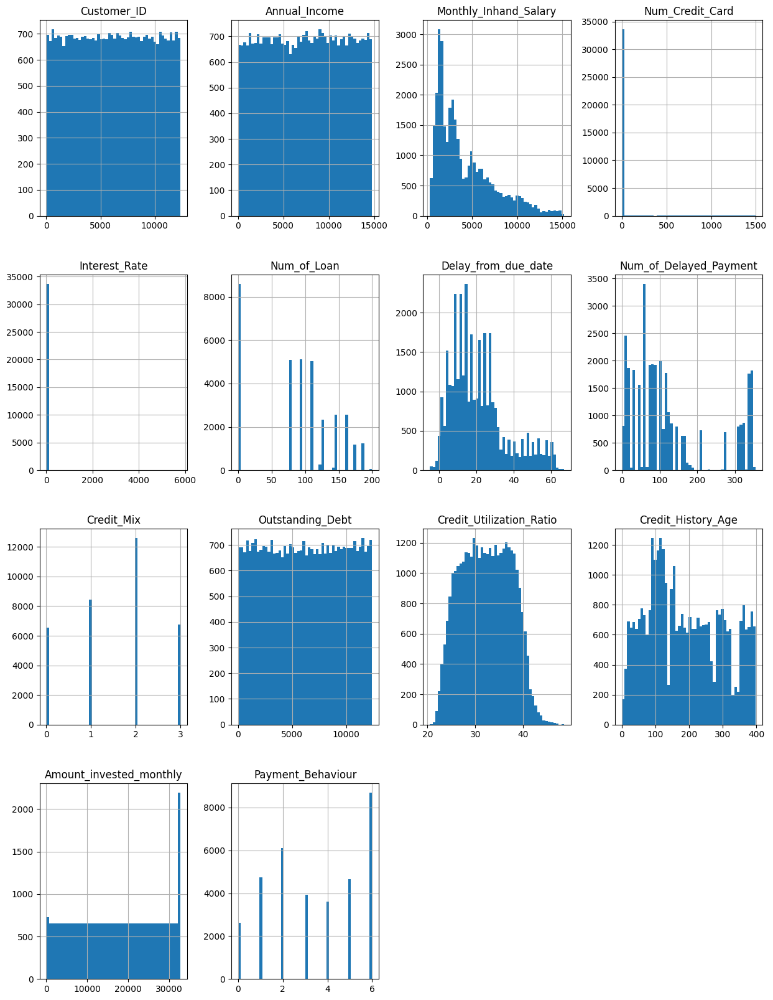

In [21]:
df.hist(bins=50,figsize=(15,20))

C:\Users\rupok\AppData\Local\Temp\ipykernel_8008\107776459.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df)


<Axes: ylabel='Density'>

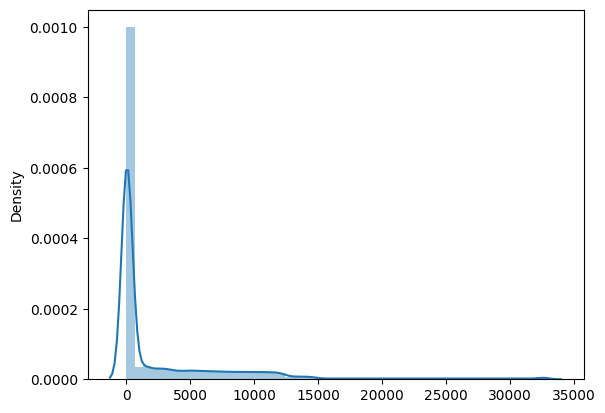

In [22]:
sns.distplot(df)

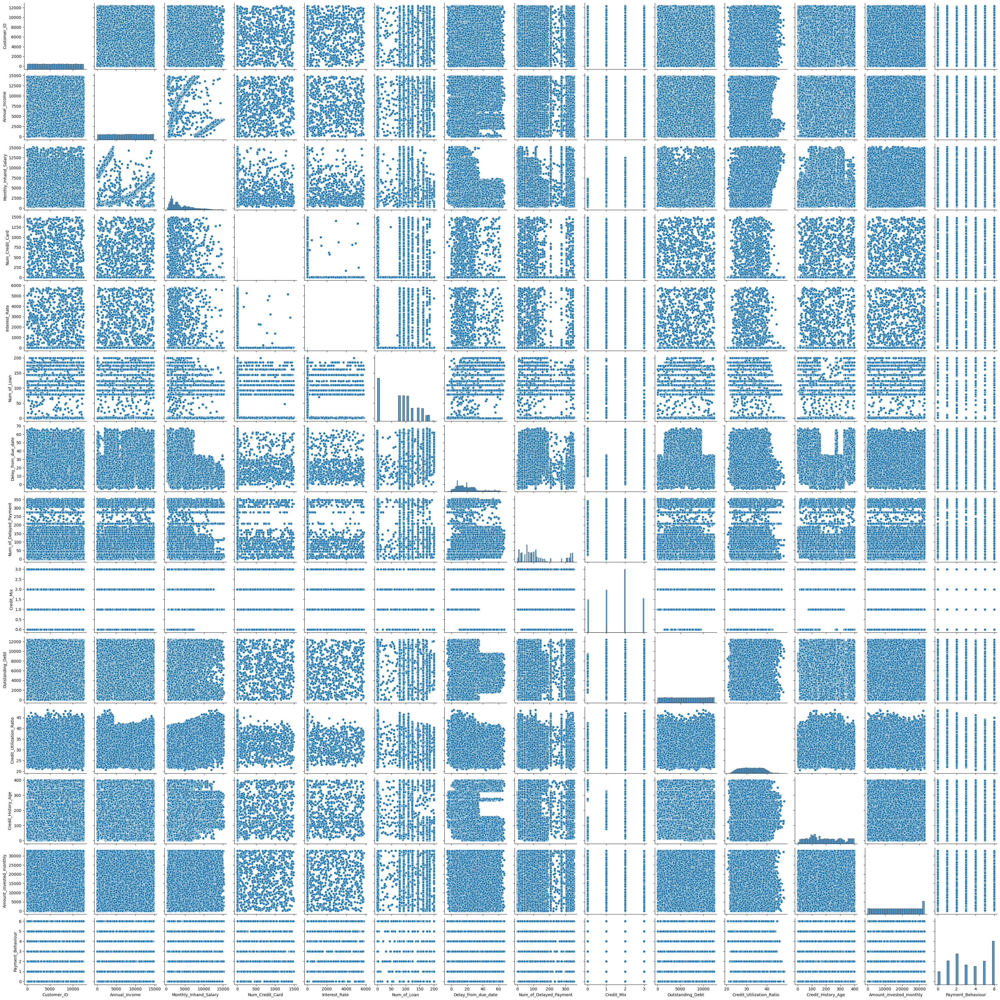

In [23]:
sns.pairplot(df)

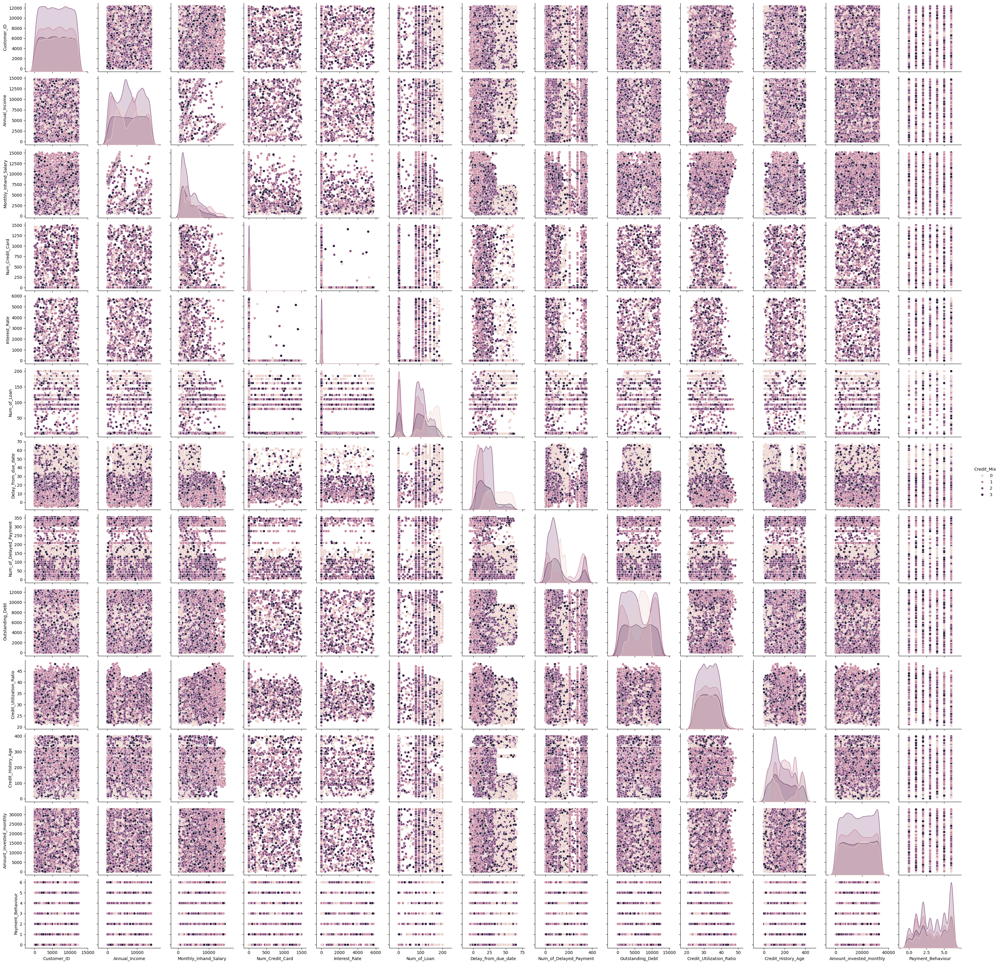

In [24]:
sns.pairplot(df, hue = 'Credit_Mix')

<Axes: xlabel='Credit_Mix', ylabel='count'>

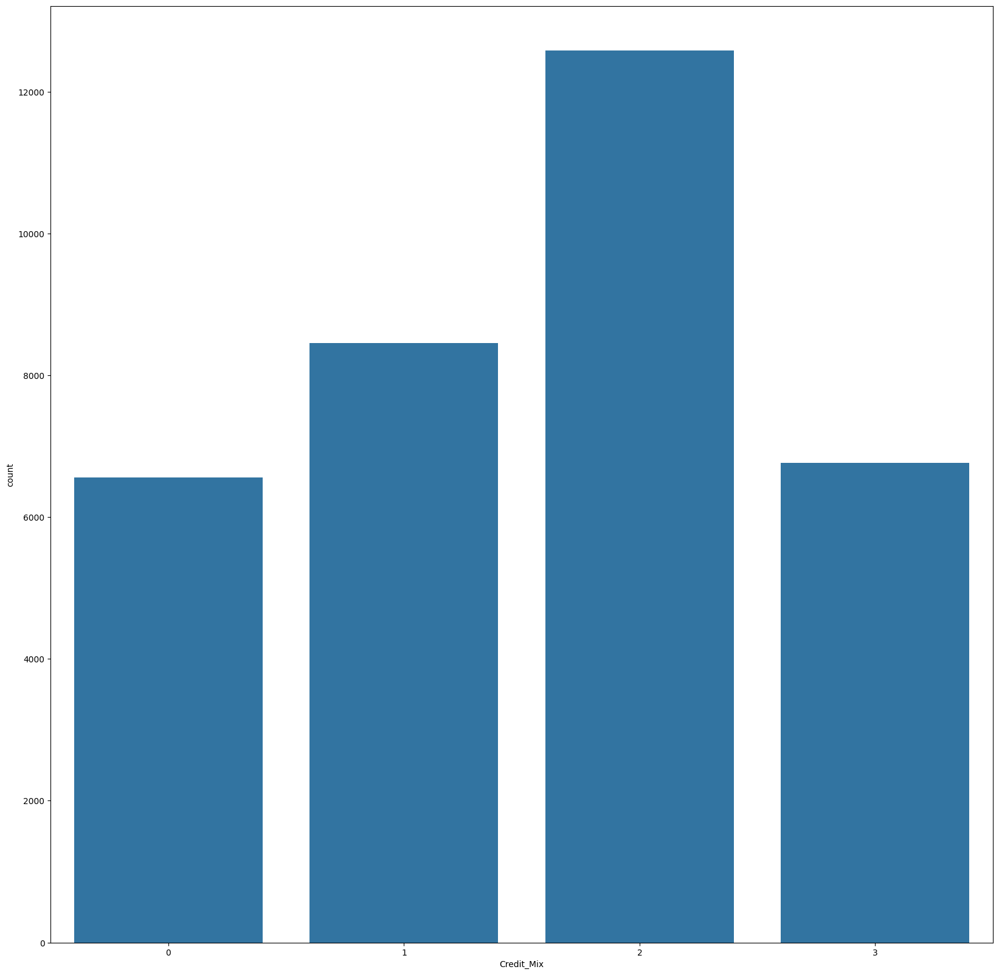

In [25]:
plt.figure(figsize=(20,20))
sns.countplot(x='Credit_Mix', data=df)

In [26]:
cor = df.corr()

<Axes: >

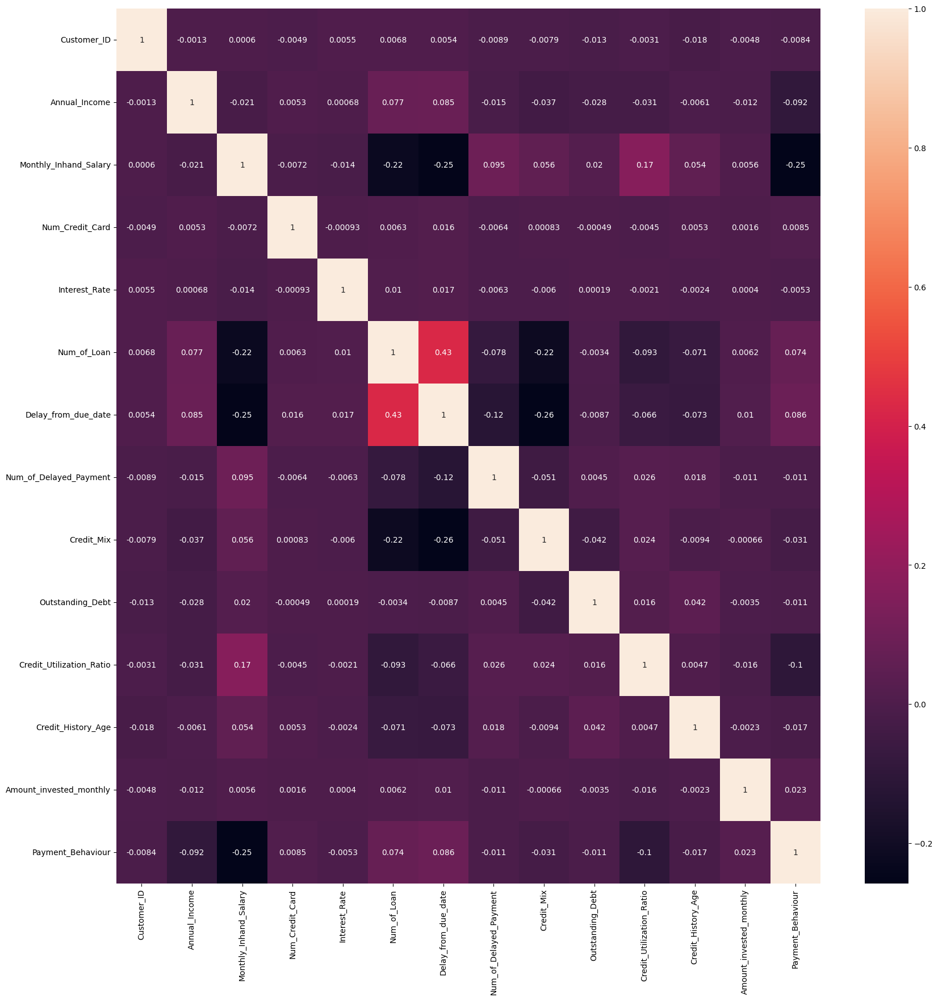

In [27]:
plt.figure(figsize=(20,20))
sns.heatmap(cor,annot=True)

In [28]:
pro =ProfileReport(df,title='Report',explorative=True)

In [29]:
pro

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 57.68it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<Axes: >

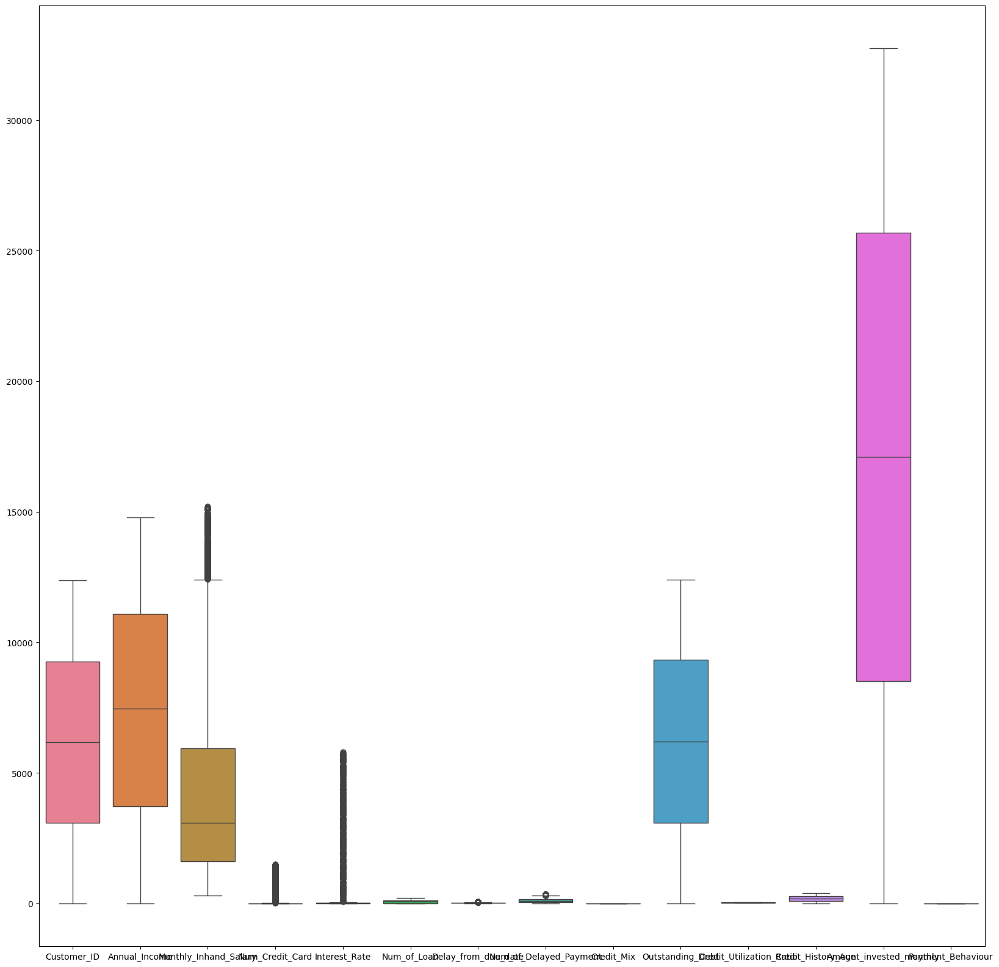

In [30]:
plt.figure(figsize=(20, 20))
sns.boxplot(df)

In [31]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

df_no_outliers = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]

<Axes: >

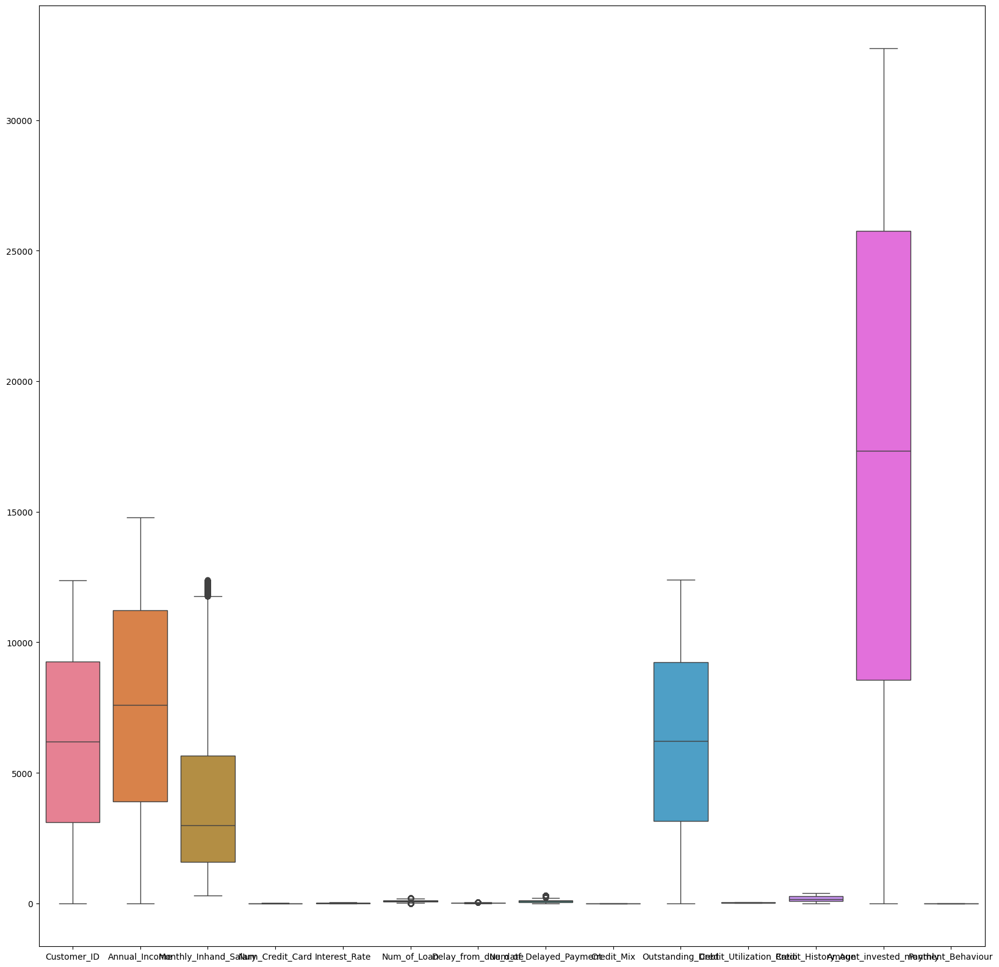

In [32]:
plt.figure(figsize=(20, 20))
sns.boxplot(df_no_outliers)

In [33]:
x = df_no_outliers.drop('Credit_Mix',axis=1)
y = df_no_outliers['Credit_Mix']

In [34]:
min_max = MinMaxScaler()

In [35]:
min_x =min_max.fit_transform(x)
X = pd.DataFrame(min_x,columns = x.columns)

In [36]:
sm = SMOTE()

In [37]:
re_x,re_y = sm.fit_resample(X,y)

In [38]:
re_y.value_counts()

Credit_Mix
1    10109
3    10109
2    10109
0    10109
Name: count, dtype: int64

In [39]:
xtrain,xtest,ytrain,ytest = train_test_split(re_x,re_y,train_size=0.70,random_state=5)

In [40]:
x_test,x_val,y_test,y_val = train_test_split(xtest,ytest,test_size=0.50,random_state=10)

In [41]:
ramdom = RandomForestClassifier(random_state=5)

In [42]:
ramdom.fit(xtrain,ytrain)

RandomForestClassifier(random_state=5)

In [43]:
y_train_pre_ram = ramdom.predict(xtrain)
y_test_pre_ram = ramdom.predict(x_test)

In [44]:
acc_train_ram = accuracy_score(ytrain,y_train_pre_ram)
class_rep_ram_train = classification_report(ytrain,y_train_pre_ram)
conf_mat_ram_train = confusion_matrix(ytrain,y_train_pre_ram)
print("Random Forest Model Evluction With Train Data ")
print("Accuracy Score :",acc_train_ram)
print("Classfication Report :",class_rep_ram_train)
print("Confusion Matrix :",conf_mat_ram_train)

Random Forest Model Evluction With Train Data 
Accuracy Score : 1.0
Classfication Report :               precision    recall  f1-score   support

           0       1.00      1.00      1.00      7092
           1       1.00      1.00      1.00      7029
           2       1.00      1.00      1.00      7077
           3       1.00      1.00      1.00      7107

    accuracy                           1.00     28305
   macro avg       1.00      1.00      1.00     28305
weighted avg       1.00      1.00      1.00     28305

Confusion Matrix : [[7092    0    0    0]
 [   0 7029    0    0]
 [   0    0 7077    0]
 [   0    0    0 7107]]


In [45]:
acc_test_ram = accuracy_score(y_test,y_test_pre_ram )
class_rep_ram_test = classification_report(y_test,y_test_pre_ram )
conf_mat_ram_test = confusion_matrix(y_test,y_test_pre_ram )
print("Decision Tree Model Evluction With Test Data ")
print("Accuracy Score :",acc_test_ram)
print("Classfication Report :",class_rep_ram_test)
print("Confusion Matrix :",conf_mat_ram_test)

Decision Tree Model Evluction With Test Data 
Accuracy Score : 0.7874690849134378
Classfication Report :               precision    recall  f1-score   support

           0       0.81      0.97      0.89      1494
           1       0.82      0.93      0.87      1567
           2       0.74      0.85      0.79      1494
           3       0.76      0.39      0.52      1510

    accuracy                           0.79      6065
   macro avg       0.78      0.79      0.77      6065
weighted avg       0.78      0.79      0.77      6065

Confusion Matrix : [[1450    0   13   31]
 [   0 1464   55   48]
 [  54   63 1271  106]
 [ 278  264  377  591]]


In [46]:
param_grid_ran = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2,5],
    'max_features': ['auto', 'sqrt', 'log2'],
    'bootstrap': [True, False],
    'criterion': ['gini', 'entropy']
}

In [47]:
grid_search = GridSearchCV(estimator=ramdom,
                           param_grid=param_grid_ran,
                           cv=5,
                           n_jobs=-1,
                           verbose=2,
                           scoring='accuracy')

grid_search.fit(xtrain, ytrain)

Fitting 5 folds for each of 648 candidates, totalling 3240 fits


C:\Users\rupok\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py:528: FitFailedWarning: 
1080 fits failed out of a total of 3240.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
916 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\rupok\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\rupok\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1382, in wrapper
    estimator._validate_params()
  File "C:\Users\rupok\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ba

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=5), n_jobs=-1,
             param_grid={'bootstrap': [True, False],
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 10, 20],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [1, 2, 5],
                         'min_samples_split': [2, 5],
                         'n_estimators': [50, 100, 200]},
             scoring='accuracy', verbose=2)

In [48]:
print("Best Parameters:", grid_search.best_params_)
print("Best CV Accuracy:", grid_search.best_score_)

best_model = grid_search.best_estimator_

y_pred = best_model.predict(x_val)
print(classification_report(y_val, y_pred))

Best Parameters: {'bootstrap': False, 'criterion': 'gini', 'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Best CV Accuracy: 0.7831478537360889
              precision    recall  f1-score   support

           0       0.83      0.97      0.89      1523
           1       0.83      0.94      0.88      1513
           2       0.78      0.85      0.81      1538
           3       0.74      0.44      0.55      1492

    accuracy                           0.80      6066
   macro avg       0.79      0.80      0.78      6066
weighted avg       0.79      0.80      0.79      6066



In [49]:
decision= DecisionTreeClassifier(random_state=10)

In [50]:
decision.fit(xtrain,ytrain)

DecisionTreeClassifier(random_state=10)

In [51]:
y_train_decision = decision.predict(xtrain)
y_test_decision = decision.predict(x_test)

In [52]:
acc_train_dec = accuracy_score(ytrain,y_train_decision)
class_rep_dec_train = classification_report(ytrain,y_train_decision)
conf_mat_dec_train = confusion_matrix(ytrain,y_train_decision)
print("Decision Tree Model Evluction With Train Data ")
print("Accuracy Score :",acc_train_dec)
print("Classfication Report :",class_rep_dec_train)
print("Confusion Matrix :",conf_mat_dec_train)

Decision Tree Model Evluction With Train Data 
Accuracy Score : 1.0
Classfication Report :               precision    recall  f1-score   support

           0       1.00      1.00      1.00      7092
           1       1.00      1.00      1.00      7029
           2       1.00      1.00      1.00      7077
           3       1.00      1.00      1.00      7107

    accuracy                           1.00     28305
   macro avg       1.00      1.00      1.00     28305
weighted avg       1.00      1.00      1.00     28305

Confusion Matrix : [[7092    0    0    0]
 [   0 7029    0    0]
 [   0    0 7077    0]
 [   0    0    0 7107]]


In [53]:
acc_test_dec = accuracy_score(y_test,y_test_decision)
class_rep_dec_test = classification_report(y_test,y_test_decision)
conf_mat_dec_test = confusion_matrix(y_test,y_test_decision)
print("Decision Tree Model Evluction With Test Data ")
print("Accuracy Score :",acc_test_dec)
print("Classfication Report :",class_rep_dec_test)
print("Confusion Matrix :",conf_mat_dec_test)

Decision Tree Model Evluction With Test Data 
Accuracy Score : 0.6707337180544105
Classfication Report :               precision    recall  f1-score   support

           0       0.81      0.79      0.80      1494
           1       0.79      0.78      0.78      1567
           2       0.67      0.65      0.66      1494
           3       0.43      0.46      0.45      1510

    accuracy                           0.67      6065
   macro avg       0.67      0.67      0.67      6065
weighted avg       0.68      0.67      0.67      6065

Confusion Matrix : [[1179    0   47  268]
 [   0 1221   95  251]
 [  48   89  972  385]
 [ 228  242  344  696]]


In [54]:
param_grid_di = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 5, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2'],
    'max_leaf_nodes': [None, 10, 20, 50],
    'min_weight_fraction_leaf': [0.0, 0.01, 0.05],
    'class_weight': [None, 'balanced'],
    'ccp_alpha': [0.0, 0.01, 0.1]
}

In [55]:
grid_search_di = GridSearchCV(
    estimator=decision,
    param_grid=param_grid_di,
    scoring='accuracy',
    cv=5,
    n_jobs=-1,
    verbose=2
)

grid_search_di.fit(xtrain, ytrain)

Fitting 5 folds for each of 58320 candidates, totalling 291600 fits


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=10), n_jobs=-1,
             param_grid={'ccp_alpha': [0.0, 0.01, 0.1],
                         'class_weight': [None, 'balanced'],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [None, 5, 10, 20, 30],
                         'max_features': [None, 'sqrt', 'log2'],
                         'max_leaf_nodes': [None, 10, 20, 50],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'min_weight_fraction_leaf': [0.0, 0.01, 0.05],
                         'splitter': ['best', 'random']},
             scoring='accuracy', verbose=2)

In [56]:
print("Best Parameters:", grid_search.best_params_)
print("Best CV Accuracy:", grid_search.best_score_)

# Predict and evaluate
y_pred_dis = grid_search.best_estimator_.predict(x_val)
print(classification_report(y_val, y_pred_dis))

Best Parameters: {'bootstrap': False, 'criterion': 'gini', 'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Best CV Accuracy: 0.7831478537360889
              precision    recall  f1-score   support

           0       0.83      0.97      0.89      1523
           1       0.83      0.94      0.88      1513
           2       0.78      0.85      0.81      1538
           3       0.74      0.44      0.55      1492

    accuracy                           0.80      6066
   macro avg       0.79      0.80      0.78      6066
weighted avg       0.79      0.80      0.79      6066



In [57]:
import joblib

In [58]:
joblib.dump(grid_search,'random_forest_model.pkl')


['random_forest_model.pkl']

In [59]:
joblib.dump(grid_search_di, 'best_decision_tree_model.pkl')

['best_decision_tree_model.pkl']

In [60]:
# model
from xgboost import XGBClassifier

In [61]:
xgb = XGBClassifier()

In [62]:
xgb.fit(xtrain,ytrain)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              feature_weights=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=None,
              n_jobs=None, num_parallel_tree=None, ...)

In [63]:
y_train_xgb = xgb.predict(xtrain)
y_test_xgb = xgb.predict(x_test)

In [64]:
acc_train_xgb = accuracy_score(ytrain,y_train_xgb)
class_rep_xgb_train = classification_report(ytrain,y_train_xgb)
conf_mat_xgb_train = confusion_matrix(ytrain,y_train_xgb)
print("Decision Tree Model Evluction With Train Data ")
print("Accuracy Score :",acc_train_xgb)
print("Classfication Report :",class_rep_xgb_train)
print("Confusion Matrix :",conf_mat_xgb_train)

Decision Tree Model Evluction With Train Data 
Accuracy Score : 0.8754636989931107
Classfication Report :               precision    recall  f1-score   support

           0       0.87      0.99      0.93      7092
           1       0.89      0.96      0.92      7029
           2       0.82      0.97      0.89      7077
           3       0.97      0.58      0.73      7107

    accuracy                           0.88     28305
   macro avg       0.89      0.88      0.87     28305
weighted avg       0.89      0.88      0.87     28305

Confusion Matrix : [[7031    0   38   23]
 [   0 6772  180   77]
 [ 114   88 6853   22]
 [ 950  765 1268 4124]]


In [65]:
acc_test_xgb = accuracy_score(y_test,y_test_xgb)
class_rep_xgb_test = classification_report(y_test,y_test_xgb)
conf_mat_xgb_test = confusion_matrix(y_test,y_test_xgb)
print("Decision Tree Model Evluction With Test Data ")
print("Accuracy Score :",acc_test_xgb)
print("Classfication Report :",class_rep_xgb_test)
print("Confusion Matrix :",conf_mat_xgb_test)

Decision Tree Model Evluction With Test Data 
Accuracy Score : 0.7686727122835944
Classfication Report :               precision    recall  f1-score   support

           0       0.79      0.96      0.87      1494
           1       0.79      0.91      0.85      1567
           2       0.72      0.89      0.80      1494
           3       0.76      0.31      0.44      1510

    accuracy                           0.77      6065
   macro avg       0.77      0.77      0.74      6065
weighted avg       0.77      0.77      0.74      6065

Confusion Matrix : [[1435    0   25   34]
 [   0 1423   78   66]
 [  47   64 1331   52]
 [ 328  304  405  473]]


In [66]:
param_grid_xgb = {
    'max_depth': [3, 4, 5],
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [50, 100, 150],
    'subsample': [0.7, 0.8, 1.0],
    'colsample_bytree': [0.7, 0.8, 1.0]
}

In [67]:
grid_search_xgb = GridSearchCV(estimator=xgb,
                           param_grid=param_grid_xgb,
                           scoring='accuracy',
                           cv=5,
                           verbose=1,
                           n_jobs=-1)

In [68]:
grid_search_xgb.fit(xtrain, ytrain)

Fitting 5 folds for each of 243 candidates, totalling 1215 fits


GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, feature_weights=None,
                                     gamma=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=Non...
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None, ...),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.7, 0.8, 1.0],
                         'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 4, 5], 'n_estimators': [50, 100, 150],
                         'subsample': [0.7, 0.8, 1.0]},
             scoring='accuracy', verbose=1)

In [69]:
print("Best Parameters:", grid_search_xgb.best_params_)

Best Parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 150, 'subsample': 0.7}


In [83]:
print("After XGBoost Model Hyprameter Tuning")
best_model = grid_search_xgb.best_estimator_
y_pred_xgb = best_model.predict(x_val)
print("\nClassification Report:\n", classification_report(y_val, y_pred))
print("Accuracy score :",accuracy_score(y_val, y_pred_xgb))
print("Confuction Matrix :",confusion_matrix(y_val, y_pred_xgb))

After XGBoost Model Hyprameter Tuning

Classification Report:
               precision    recall  f1-score   support

           0       0.83      0.97      0.89      1523
           1       0.83      0.94      0.88      1513
           2       0.78      0.85      0.81      1538
           3       0.74      0.44      0.55      1492

    accuracy                           0.80      6066
   macro avg       0.79      0.80      0.78      6066
weighted avg       0.79      0.80      0.79      6066

Accuracy score : 0.7644246620507749
Confuction Matrix : [[1462    0   19   42]
 [   0 1376   85   52]
 [  72   54 1386   26]
 [ 345  361  373  413]]


In [84]:
joblib.dump(best_model, 'best_decision_tree_model.pkl')

['best_decision_tree_model.pkl']

In [85]:
print("After Decission Tree Model Hyperprameter Tuning")

print("Best CV Accuracy:", grid_search.best_score_)


y_pred_dis = grid_search.best_estimator_.predict(x_val)
print(classification_report(y_val, y_pred_dis))
print("Confuction Matrix :",confusion_matrix(y_val, y_pred_dis))

After Decission Tree Model Hyperprameter Tuning
Best CV Accuracy: 0.7831478537360889
              precision    recall  f1-score   support

           0       0.83      0.97      0.89      1523
           1       0.83      0.94      0.88      1513
           2       0.78      0.85      0.81      1538
           3       0.74      0.44      0.55      1492

    accuracy                           0.80      6066
   macro avg       0.79      0.80      0.78      6066
weighted avg       0.79      0.80      0.79      6066

Confuction Matrix : [[1470    0   10   43]
 [   0 1429   38   46]
 [  46   44 1306  142]
 [ 257  253  324  658]]


In [86]:
print("After Random Forest Model Hyperprameter Tuning")
print("Best CV Accuracy:", grid_search.best_score_)

best_model = grid_search.best_estimator_

y_pred = best_model.predict(x_val)
print(classification_report(y_val, y_pred))
print("Confuction Matrix :",confusion_matrix(y_val, y_pred))

After Random Forest Model Hyperprameter Tuning
Best CV Accuracy: 0.7831478537360889
              precision    recall  f1-score   support

           0       0.83      0.97      0.89      1523
           1       0.83      0.94      0.88      1513
           2       0.78      0.85      0.81      1538
           3       0.74      0.44      0.55      1492

    accuracy                           0.80      6066
   macro avg       0.79      0.80      0.78      6066
weighted avg       0.79      0.80      0.79      6066

Confuction Matrix : [[1470    0   10   43]
 [   0 1429   38   46]
 [  46   44 1306  142]
 [ 257  253  324  658]]
